In [1]:
import os
import time
import argparse
import math
import random
import numpy as np
import pybullet as p
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D  
import seaborn as sns

from datetime import datetime
from gym_pybullet_drones.utils.enums import DroneModel, Physics
from gym_pybullet_drones.envs.CtrlAviary import CtrlAviary
from controllers.pid_controller import DSLPIDControl
from gym_pybullet_drones.utils.Logger import Logger
from gym_pybullet_drones.utils.utils import sync, str2bool
from utils.utils import initialize_drones

# Default parameters
DEFAULT_DRONES = DroneModel("cf2x")
DEFAULT_NUM_DRONES = 10
DEFAULT_PHYSICS = Physics("pyb")
DEFAULT_GUI = True
DEFAULT_RECORD_VISION = False
DEFAULT_PLOT = True
DEFAULT_USER_DEBUG_GUI = False
DEFAULT_OBSTACLES = False
DEFAULT_SIMULATION_FREQ_HZ = 240
DEFAULT_CONTROL_FREQ_HZ = 120
DEFAULT_DURATION_SEC = 30
DEFAULT_OUTPUT_FOLDER = 'results'
DEFAULT_COLAB = False

pybullet build time: Dec 23 2024 16:41:47


In [2]:
# Global parameters for formation control
R = 1.3              # Leader's circular trajectory radius (for default, V, line, triangle modes)
d = 0.7             # Relative offset distance used in various formations
circle_radius = 2.0  # Radius used for circle formation

# Parameters for collision avoidance
SAFE_DISTANCE = 0.7      # Minimum allowed distance between drones
AVOIDANCE_GAIN = 0.5     # Gain multiplier for repulsion effect

# Global variables for formation mode and simulation time reference
formation_mode = "default"  # default: leader-follower
simulation_start = None

def get_formation_targets(num_drones):
    """
    Computes target positions for the drones based on the global formation_mode.
    
    Modes:
      - "default": Leader-follower (with simple alternating offsets)
      - "v": V formation with leader at the apex.
      - "circle": Drones evenly on a circle centered at the leader.
      - "line": Drones lined up along the negative X-axis of the leader.
      - "square": Drones evenly along a square's perimeter centered on the leader.
      - "grid": Drones arranged in a grid centered on the leader.
      - "triangle": Drones distributed along the edges of an equilateral triangle.
    """
    global formation_mode
    t = time.time() - simulation_start
    # Leader position along circular trajectory (for default, v, line, triangle)
    leader_x = R * math.cos(0.2 * t)
    leader_y = R * math.sin(0.2 * t)
    leader_z = 1.0  # Constant altitude
    leader_pos = np.array([leader_x, leader_y, leader_z])
    
    target_positions = np.zeros((num_drones, 3))
    
    if formation_mode in ["default", "v", "line", "triangle"]:
        # Leader is drone 0
        target_positions[0] = leader_pos
        
        if formation_mode == "default":
            # Default: Follower drones maintain alternating fixed offsets relative to leader.
            for i in range(1, num_drones):
                if i % 2 == 0:
                    offset = np.array([d, 0.0, 0.0])
                else:
                    offset = np.array([-d, 0.0, 0.0])
                target_positions[i] = leader_pos + offset

        elif formation_mode == "v":
            # V formation: Leader at apex. Alternate drones placed along the arms of a V.
            for i in range(1, num_drones):
                idx = (i + 1) // 2  # determines the distance from the leader
                if i % 2 == 1:
                    # Right wing: offset to the right and backwards
                    offset = np.array([-idx * d, idx * d, 0])
                else:
                    # Left wing: offset to the left and backwards
                    offset = np.array([-idx * d, -idx * d, 0])
                target_positions[i] = leader_pos + offset

        elif formation_mode == "line":
            # Line formation: Drones line up along the negative X-axis from leader.
            for i in range(1, num_drones):
                offset = np.array([-i * d, 0, 0])
                target_positions[i] = leader_pos + offset

        elif formation_mode == "triangle":
            # Triangle formation: Place drones along the perimeter of an equilateral triangle.
            side = 2 * d * (num_drones / 4)  # side length scaled with number of drones
            v1 = leader_pos  # Leader vertex
            # Compute approximate vertices for an equilateral triangle
            v2 = leader_pos + np.array([-side, side * math.tan(math.radians(30)), 0])
            v3 = leader_pos + np.array([side, side * math.tan(math.radians(30)), 0])
            edges = [(v1, v2), (v2, v3), (v3, v1)]
            followers = num_drones - 1
            per_edge = max(1, followers // 3)
            idx = 1
            for (start, end) in edges:
                for j in range(1, per_edge + 1):
                    if idx >= num_drones:
                        break
                    ratio = j / (per_edge + 1)
                    point = start * (1 - ratio) + end * ratio
                    target_positions[idx] = point
                    idx += 1
            while idx < num_drones:
                ratio = (idx) / (followers + 1)
                point = v1 * (1 - ratio) + v2 * ratio
                target_positions[idx] = point
                idx += 1

    elif formation_mode == "circle":
        # Circle formation: Leader's position is the center of the circle.
        center = leader_pos
        for i in range(num_drones):
            angle = (2 * math.pi / num_drones) * i
            offset = np.array([circle_radius * math.cos(angle),
                               circle_radius * math.sin(angle),
                               0])
            target_positions[i] = center + offset

    elif formation_mode == "square":
        # Square formation: Arrange drones along the perimeter of a square centered on leader.
        center = leader_pos
        side_len = 2 * d * math.sqrt(num_drones)  # side length scaled with number of drones
        perimeter = 4 * side_len
        remaining = num_drones - 1
        for i in range(1, num_drones):
            fraction = ((i - 1) / remaining) * perimeter
            if fraction < side_len:
                pos = np.array([-side_len/2 + fraction, side_len/2, 0])
            elif fraction < 2 * side_len:
                pos = np.array([side_len/2, side_len/2 - (fraction - side_len), 0])
            elif fraction < 3 * side_len:
                pos = np.array([side_len/2 - (fraction - 2*side_len), -side_len/2, 0])
            else:
                pos = np.array([-side_len/2, -side_len/2 + (fraction - 3*side_len), 0])
            target_positions[i] = center + pos

    elif formation_mode == "grid":
        # Grid formation: Arrange drones in rows and columns centered around leader.
        center = leader_pos
        cols = math.ceil(math.sqrt(num_drones))
        rows = math.ceil(num_drones / cols)
        spacing = d * 2
        x_offsets = (np.arange(cols) - (cols - 1) / 2.0) * spacing
        y_offsets = (np.arange(rows) - (rows - 1) / 2.0) * spacing
        
        grid_points = []
        for r_idx in range(rows):
            for c_idx in range(cols):
                grid_points.append(np.array([x_offsets[c_idx], y_offsets[r_idx], 0]))
        for i in range(num_drones):
            target_positions[i] = center + grid_points[i]
    
    return target_positions

def apply_collision_avoidance(target_positions, obs, safe_distance=SAFE_DISTANCE, avoidance_gain=AVOIDANCE_GAIN):
    """
    Adjusts the formation target positions using a basic repulsive potential field.
    For each drone, if any other drone is closer than safe_distance (based on current positions),
    a repulsion term is added to the target position.
    
    Parameters:
      - target_positions: np.array shape (num_drones, 3)
      - obs: list/array of states; assume first 3 entries are [x, y, z]
      - safe_distance: minimum allowed separation
      - avoidance_gain: scaling factor for repulsion force
    """
    num_drones = target_positions.shape[0]
    adjusted_targets = np.copy(target_positions)
    
    # Loop through each drone
    for i in range(num_drones):
        pos_i = np.array(obs[i][:3])
        repulsion = np.zeros(3)
        
        # Compare with every other drone
        for j in range(num_drones):
            if i == j:
                continue
            pos_j = np.array(obs[j][:3])
            diff = pos_i - pos_j
            distance = np.linalg.norm(diff)
            # If drones are too close, add a repulsion force
            if distance < safe_distance and distance > 1e-6:
                repulsion += avoidance_gain * (diff / distance) * (safe_distance - distance)
        adjusted_targets[i] += repulsion
    return adjusted_targets

def check_keyboard_events():
    """
    Checks for keyboard events and updates the global formation_mode.
    
    Keys:
      - "v": V formation
      - "c": Circle formation
      - "l": Line formation
      - "s": Square formation
      - "g": Grid formation
      - "t": Triangle formation
    """
    global formation_mode
    keys = p.getKeyboardEvents()
    for k, v in keys.items():
        if (k == ord('v')) and (v & p.KEY_WAS_TRIGGERED):
            formation_mode = "v"
            print("Switched to V formation")
        elif (k == ord('c')) and (v & p.KEY_WAS_TRIGGERED):
            formation_mode = "circle"
            print("Switched to circle formation")
        elif (k == ord('l')) and (v & p.KEY_WAS_TRIGGERED):
            formation_mode = "line"
            print("Switched to line formation")
        elif (k == ord('s')) and (v & p.KEY_WAS_TRIGGERED):
            formation_mode = "square"
            print("Switched to square formation")
        elif (k == ord('g')) and (v & p.KEY_WAS_TRIGGERED):
            formation_mode = "grid"
            print("Switched to grid formation")
        elif (k == ord('t')) and (v & p.KEY_WAS_TRIGGERED):
            formation_mode = "triangle"
            print("Switched to triangle formation")

def run(
        drone=DEFAULT_DRONES,
        num_drones=DEFAULT_NUM_DRONES,
        physics=DEFAULT_PHYSICS,
        gui=DEFAULT_GUI,
        record_video=DEFAULT_RECORD_VISION,
        plot=DEFAULT_PLOT,
        user_debug_gui=DEFAULT_USER_DEBUG_GUI,
        obstacles=DEFAULT_OBSTACLES,
        simulation_freq_hz=DEFAULT_SIMULATION_FREQ_HZ,
        control_freq_hz=DEFAULT_CONTROL_FREQ_HZ,
        duration_sec=DEFAULT_DURATION_SEC,
        output_folder=DEFAULT_OUTPUT_FOLDER,
        colab=DEFAULT_COLAB
        ):
    global simulation_start, formation_mode
    simulation_start = time.time()
    formation_mode = "line"

    INIT_XYZS = initialize_drones(num_drones, 0.5, [-3, 3])
    INIT_RPYS = np.array([[0, 0, 0] for i in range(num_drones)])
    target_xyzs = np.array([[0, i * d, 1] for i in range(num_drones)])
    target_rpys = np.array([[0, 0, 0] for i in range(num_drones)])

    env = CtrlAviary(drone_model=drone,
                     num_drones=num_drones,
                     initial_xyzs=INIT_XYZS,
                     initial_rpys=INIT_RPYS,
                     physics=physics,
                     neighbourhood_radius=10,
                     pyb_freq=simulation_freq_hz,
                     ctrl_freq=control_freq_hz,
                     gui=gui,
                     record=record_video,
                     obstacles=obstacles,
                     user_debug_gui=user_debug_gui
                     )

    PYB_CLIENT = env.getPyBulletClient()
    p.configureDebugVisualizer(p.COV_ENABLE_GUI,0)
    logger = Logger(logging_freq_hz=control_freq_hz,
                    num_drones=num_drones,
                    output_folder=output_folder,
                    colab=colab)

    if drone in [DroneModel.CF2X, DroneModel.CF2P]:
        ctrl = [DSLPIDControl(drone_model=drone) for i in range(num_drones)]

    action = np.zeros((num_drones, 4))
    START = time.time()
    for i in range(0, int(duration_sec * env.CTRL_FREQ)):
        obs, reward, terminated, truncated, info = env.step(action)
        check_keyboard_events()
        if (time.time() - simulation_start) > 30:
            formation_mode = 'v'
        target_xyzs = get_formation_targets(num_drones)
        # Apply collision avoidance adjustment to target positions
        target_xyzs = apply_collision_avoidance(target_xyzs, obs, safe_distance=SAFE_DISTANCE, avoidance_gain=AVOIDANCE_GAIN)

        for j in range(num_drones):
            action[j, :], _, _ = ctrl[j].computeControlFromState(
                                        control_timestep=env.CTRL_TIMESTEP,
                                        state=obs[j],
                                        target_pos=target_xyzs[j],
                                        target_rpy=target_rpys[j, :]
                                    )
        for j in range(num_drones):
            logger.log(drone=j,
                       timestamp=i / env.CTRL_FREQ,
                       state=obs[j],
                       control=np.hstack((target_xyzs[j, :], target_rpys[j, :], np.zeros(6)))
                       )

        env.render()
        if gui:
            sync(i, START, env.CTRL_TIMESTEP)

    env.close()

    states = logger.states
    controls = logger.controls
    timestamps = logger.timestamps

    return states, controls, timestamps

states, controls, timestamps = run()


[INFO] BaseAviary.__init__() loaded parameters from the drone's .urdf:
[INFO] m 0.027000, L 0.039700,
[INFO] ixx 0.000014, iyy 0.000014, izz 0.000022,
[INFO] kf 0.000000, km 0.000000,
[INFO] t2w 2.250000, max_speed_kmh 30.000000,
[INFO] gnd_eff_coeff 11.368590, prop_radius 0.023135,
[INFO] drag_xy_coeff 0.000001, drag_z_coeff 0.000001,
[INFO] dw_coeff_1 2267.180000, dw_coeff_2 0.160000, dw_coeff_3 -0.110000
Version = 4.1 Metal - 89.3
Vendor = Apple
Renderer = Apple M1
b3Printf: Selected demo: Physics Server
startThreads creating 1 threads.
starting thread 0
started thread 0 
MotionThreadFunc thread started
viewMatrix (0.8660253882408142, 0.2499999701976776, -0.4330126941204071, 0.0, -0.4999999701976776, 0.4330126643180847, -0.75, 0.0, 0.0, 0.8660253882408142, 0.4999999701976776, 0.0, 5.3016201206901314e-08, -4.5773340673349594e-08, -3.0, 1.0)
projectionMatrix (0.7499999403953552, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, -1.0000200271606445, -1.0, 0.0, 0.0, -0.02000020071864128, 0.0

2025-04-14 14:01:43.108 python[43326:16383915] +[IMKClient subclass]: chose IMKClient_Modern
2025-04-14 14:01:43.108 python[43326:16383915] +[IMKInputSession subclass]: chose IMKInputSession_Modern
/Users/timii/miniforge3/envs/ai/lib/python3.12/site-packages/gymnasium/spaces/box.py:235: UserWarning: WARN: Box low's precision lowered by casting to float32, current low.dtype=float64
  gym.logger.warn(
/Users/timii/miniforge3/envs/ai/lib/python3.12/site-packages/gymnasium/spaces/box.py:305: UserWarning: WARN: Box high's precision lowered by casting to float32, current high.dtype=float64
  gym.logger.warn(



[INFO] BaseAviary.render() ——— it 0002 ——— wall-clock time 6.9s, simulation time 0.0s@240Hz (0.00x)
[INFO] BaseAviary.render() ——— drone 0 ——— x -02.81, y +01.74, z +00.00 ——— velocity -00.01, -00.01, +00.25 ——— roll +00.51, pitch -01.03, yaw +00.01 ——— angular velocity -0.0215, +0.4447, +0.0769 ——— 
[INFO] BaseAviary.render() ——— drone 1 ——— x +01.35, y -00.66, z +00.00 ——— velocity +00.01, +00.01, +00.25 ——— roll -00.60, pitch +00.99, yaw +00.01 ——— angular velocity -0.2081, -0.5440, +0.0831 ——— 
[INFO] BaseAviary.render() ——— drone 2 ——— x +00.20, y +02.15, z +00.00 ——— velocity -00.01, -00.01, +00.25 ——— roll -01.04, pitch -00.75, yaw +00.01 ——— angular velocity +0.7259, -0.5043, +0.0227 ——— 
[INFO] BaseAviary.render() ——— drone 3 ——— x -02.11, y -01.35, z +00.00 ——— velocity -00.01, +00.01, +00.25 ——— roll -00.55, pitch -01.01, yaw -00.01 ——— angular velocity -0.0715, +0.4841, -0.0797 ——— 
[INFO] BaseAviary.render() ——— drone 4 ——— x -01.65, y -01.93, z +00.00 ——— velocity +00.00

In [3]:
# Results
# Trajectory for circle 
# Trajectory for v
# Trajectory when switching from line to v (show time of switch)

# Subplots IEEE Style
# 3d and 2d trajectories
# Mean distance between drones
# Mean distance to setpoint

# states.shape == (num drones, num states, timesteps)
# controls.shape == (num drones, num desired states, timesteps)
# timestamps.shape == (num drones, timesteps)

# sns.set_style('whitegrid')
# sns.set_palette('colorblind')
# plt.rcParams.update({
#     'font.family': 'serif',        # Use serif for print-friendly appearance
#     'font.size': 9,                # General font size
#     'axes.labelsize': 9,           # Axis label font size
#     'legend.fontsize': 8,          # Legend font size
#     'xtick.labelsize': 8,          # x-axis tick label size
#     'ytick.labelsize': 8,          # y-axis tick label size
#     'figure.dpi': 600              # High resolution for export
# })

# fig, axs = plt.subplots(2, 2, figsize=(3.5, 4))

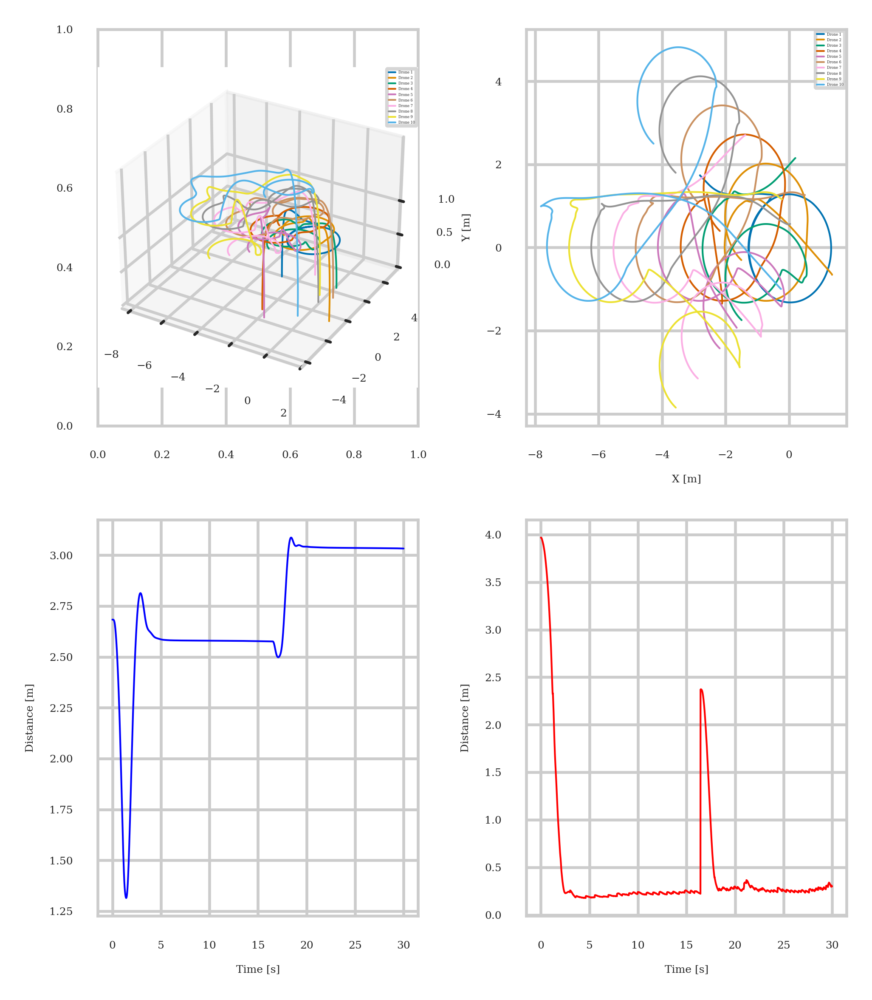

In [4]:
# IEEE-style plot settings
sns.set_style('whitegrid')
sns.set_palette('colorblind')
plt.rcParams.update({
    'font.family': 'serif',        # Print-friendly serif font
    'font.size': 5,                # General font size
    'axes.labelsize': 3,           # Axis label size
    'legend.fontsize': 3,          # Legend font size
    'xtick.labelsize': 3,          # X-axis tick size
    'ytick.labelsize': 3,          # Y-axis tick size
    'figure.dpi': 600              # High resolution for export
})

# Assumptions:
# - states.shape == (num_drones, num_states, timesteps)
#     * states[i, 0, :] = x, states[i, 1, :] = y, states[i, 2, :] = z
# - controls.shape == (num_drones, num_desired_states, timesteps)
#     * controls[i, 0, :] = desired x, controls[i, 1, :] = desired y, controls[i, 2, :] = desired z
# - timestamps.shape == (num_drones, timesteps) or a common time vector per drone

# If timestamps are the same for all drones, you can use:
t = timestamps[0, :] if timestamps.shape[0] > 0 else np.linspace(0, 10, states.shape[2])
num_drones = states.shape[0]
timesteps = states.shape[2]

# -------------------------------
# Compute Mean Inter-Drone Distance
# -------------------------------
mean_distance_between = np.zeros(timesteps)
for k in range(timesteps):
    positions = states[:, 0:3, k]  # Positions (x,y,z) for all drones
    dist_sum = 0
    count = 0
    for i in range(num_drones):
        for j in range(i+1, num_drones):
            d = np.linalg.norm(positions[i] - positions[j])
            dist_sum += d
            count += 1
    mean_distance_between[k] = dist_sum / count if count > 0 else 0

# -------------------------------
# Compute Mean Distance to Setpoint
# -------------------------------
mean_distance_to_setpoint = np.zeros(timesteps)
for k in range(timesteps):
    error_sum = 0
    for i in range(num_drones):
        # Current position vs. desired setpoint
        position = states[i, 0:3, k]
        setpoint = controls[i, 0:3, k]
        error_sum += np.linalg.norm(position - setpoint)
    mean_distance_to_setpoint[k] = error_sum / num_drones

linewidth = 0.5
labelpad = 0
# -------------------------------
# Create IEEE-Style Subplots
# -------------------------------
fig, axs = plt.subplots(2, 2, figsize=(3.5, 4))

# --- Subplot 1: 3D Trajectories ---
# For 3D plots, add a 3D axis manually
ax1 = fig.add_subplot(2, 2, 1, projection='3d')
for i in range(num_drones):
    ax1.plot(states[i, 0, :], states[i, 1, :], states[i, 2, :], label=f'Drone {i+1}', linewidth=linewidth)
# ax1.set_xlabel('X [m]', labelpad=labelpad)
# ax1.set_ylabel('Y [m]', labelpad=labelpad)
# ax1.set_zlabel('Z [m]', labelpad=labelpad)
ax1.tick_params(axis='x', labelsize=3, pad=0)
ax1.tick_params(axis='y', labelsize=3, pad=0)
ax1.tick_params(axis='z', labelsize=3, pad=0)
# ax1.set_xticks(np.arange(-3, 3, 1))
# ax1.set_yticks(np.arange(-3, 3, 1))
ax1.set_zticks(np.arange(0, 1.5, 0.5))
ax1.legend(fontsize=1)

# --- Subplot 2: 2D Trajectories (XY Projection) ---
ax2 = axs[0, 1]
for i in range(num_drones):
    ax2.plot(states[i, 0, :], states[i, 1, :], label=f'Drone {i+1}', linewidth=linewidth)
ax2.set_xlabel('X [m]')
ax2.set_ylabel('Y [m]')
ax2.legend(fontsize=1)

# --- Subplot 3: Mean Inter-Drone Distance ---
ax3 = axs[1, 0]
ax3.plot(t, mean_distance_between, 'b-', linewidth=linewidth)
ax3.set_xlabel('Time [s]')
ax3.set_ylabel('Distance [m]')
ax3.grid(True)

# --- Subplot 4: Mean Distance to Setpoint ---
ax4 = axs[1, 1]
ax4.plot(t, mean_distance_to_setpoint, 'r-', linewidth=linewidth)
ax4.set_xlabel('Time [s]')
ax4.set_ylabel('Distance [m]')
ax4.grid(True)

# Improve layout to reduce overlap
plt.tight_layout(pad=2)
plt.savefig("line_v_formation.png", dpi=600)
plt.show()

In [5]:

# def plot_trajectories(states, num_drones):
#     fig = plt.figure(figsize=(10, 10))
#     ax = fig.add_subplot(111, projection='3d')
#     for i in range(num_drones):
#         ax.plot(states[i, 0, :], states[i, 1, :], states[i, 2, :])
#     ax.set_xlabel('X Position')
#     ax.set_ylabel('Y Position')
#     ax.set_zlabel('Z Position')
#     plt.title('Drone Trajectories')
#     plt.show()
#     return fig, ax
# def plot_formation(states, num_drones):
#     fig, ax = plt.subplots(figsize=(10, 10))
#     for i in range(num_drones):
#         ax.plot(states[i, 0, :], states[i, 1, :])
#     ax.set_xlabel('X Position')
#     ax.set_ylabel('Y Position')
#     plt.title('Drone Formation in XY Plane')
#     plt.axis('equal')
#     plt.show()
#     return fig, ax

# def plot_control_inputs(controls, num_drones):
#     fig, ax = plt.subplots(figsize=(10, 10))
#     for i in range(num_drones):
#         ax.plot(controls[i, 0, :], label=f'Drone {i+1} Control Input')
#     ax.set_xlabel('Time Step')
#     ax.set_ylabel('Control Input')
#     plt.title('Control Inputs Over Time')
#     plt.legend()
#     plt.show()
#     return fig, ax

# def plot_formation_statistics(states, num_drones):
#     distances = np.zeros((states.shape[2], num_drones, num_drones))
#     for i in range(states.shape[2]):
#         for j in range(num_drones):
#             for k in range(num_drones):
#                 distances[i, j, k] = np.linalg.norm(states[j, :3, i] - states[k, :3, i])
#     min_distances = np.min(distances, axis=2)
#     max_distances = np.max(distances, axis=2)
#     mean_distances = np.mean(distances, axis=2)
    
#     fig, ax = plt.subplots(figsize=(10, 10))
#     ax.plot(mean_distances)
#     ax.set_xlabel('Time Step')
#     ax.set_ylabel('Mean Distance Between Drones')
#     plt.title('Mean Distance Between Drones Over Time') # Change function to return mean distance to setpoint
#     plt.show()
#     return fig, ax


# num_drones = states.shape[0]
# plot_trajectories(states, num_drones)
# plot_formation(states, num_drones)
# plot_control_inputs(states, num_drones)
# plot_formation_statistics(states, num_drones)

In [1]:
import os
import time
import argparse
import math
import random
import numpy as np
import pybullet as p
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D  
import seaborn as sns

from datetime import datetime
from gym_pybullet_drones.utils.enums import DroneModel, Physics
from gym_pybullet_drones.envs.CtrlAviary import CtrlAviary
from controllers.pid_controller import DSLPIDControl
from gym_pybullet_drones.utils.Logger import Logger
from gym_pybullet_drones.utils.utils import sync, str2bool
from utils.utils import initialize_drones

# === CONFIG ===
DEFAULT_DRONES = DroneModel("cf2x")
DEFAULT_NUM_DRONES = 10
DEFAULT_PHYSICS = Physics("pyb")
DEFAULT_GUI = True
DEFAULT_RECORD_VISION = False
DEFAULT_PLOT = True
DEFAULT_USER_DEBUG_GUI = False
DEFAULT_OBSTACLES = False
DEFAULT_SIMULATION_FREQ_HZ = 240
DEFAULT_CONTROL_FREQ_HZ = 120
DEFAULT_DURATION_SEC = 20
DEFAULT_OUTPUT_FOLDER = 'results'
DEFAULT_COLAB = False

CONSENSUS_GAIN = 0.1
INNER_RADIUS = 1.5           # Radius of the rotating formation
INNER_ROT_SPEED = 0.3        # Speed of rotation around formation center

OUTER_RADIUS = 10.5           # Radius of the global trajectory (formation center)
OUTER_ROT_SPEED = 0.15       # Speed of the circle center around origin


def consensus(obs, d_offsets, num_drones, sim_time, fixed_altitude=1.0):
    current_positions = np.zeros((num_drones, 2))
    target_positions = np.zeros((num_drones, 3))
    
    # Move the formation center in a circular trajectory
    center_x = OUTER_RADIUS * np.cos(OUTER_ROT_SPEED * sim_time)
    center_y = OUTER_RADIUS * np.sin(OUTER_ROT_SPEED * sim_time)
    center = np.array([center_x, center_y])

    # Rotate the local offsets
    inner_angle = INNER_ROT_SPEED * sim_time
    rotation_matrix = np.array([[np.cos(inner_angle), -np.sin(inner_angle)],
                                [np.sin(inner_angle),  np.cos(inner_angle)]])
    rotated_offsets = np.dot(d_offsets[:, :2], rotation_matrix.T)

    # Get full desired position for each drone
    desired_positions = center + rotated_offsets

    for i in range(num_drones):
        current_positions[i] = np.array(obs[i][:2])

    for i in range(num_drones):
        consensus_sum = np.zeros(2)
        for j in range(num_drones):
            if i == j:
                continue
            diff_current = current_positions[j] - current_positions[i]
            diff_desired = desired_positions[j] - desired_positions[i]
            consensus_sum += (diff_current - diff_desired)

        xy_target = current_positions[i] + CONSENSUS_GAIN * consensus_sum
        target_positions[i] = np.array([xy_target[0], xy_target[1], fixed_altitude])
    
    return target_positions


def run(
        drone=DEFAULT_DRONES,
        num_drones=DEFAULT_NUM_DRONES,
        physics=DEFAULT_PHYSICS,
        gui=DEFAULT_GUI,
        record_video=DEFAULT_RECORD_VISION,
        plot=DEFAULT_PLOT,
        user_debug_gui=DEFAULT_USER_DEBUG_GUI,
        obstacles=DEFAULT_OBSTACLES,
        simulation_freq_hz=DEFAULT_SIMULATION_FREQ_HZ,
        control_freq_hz=DEFAULT_CONTROL_FREQ_HZ,
        duration_sec=DEFAULT_DURATION_SEC,
        output_folder=DEFAULT_OUTPUT_FOLDER,
        colab=DEFAULT_COLAB
        ):

    # Offsets for a static circular formation (body frame)
    d_offsets = np.array([
        [INNER_RADIUS * np.cos(2 * np.pi * i / num_drones),
         INNER_RADIUS * np.sin(2 * np.pi * i / num_drones),
         0]
        for i in range(num_drones)
    ])

    # Initial drone placement
    INIT_XYZS = initialize_drones(num_drones, 0.5, [-3, 3])
    INIT_RPYS = np.array([[0, 0, 0] for _ in range(num_drones)])
    target_rpys = np.array([[0, 0, 0] for _ in range(num_drones)])

    env = CtrlAviary(drone_model=drone,
                     num_drones=num_drones,
                     initial_xyzs=INIT_XYZS,
                     initial_rpys=INIT_RPYS,
                     physics=physics,
                     neighbourhood_radius=10,
                     pyb_freq=simulation_freq_hz,
                     ctrl_freq=control_freq_hz,
                     gui=gui,
                     record=record_video,
                     obstacles=obstacles,
                     user_debug_gui=user_debug_gui)

    p.configureDebugVisualizer(p.COV_ENABLE_GUI, 0)
    logger = Logger(logging_freq_hz=control_freq_hz,
                    num_drones=num_drones,
                    output_folder=output_folder,
                    colab=colab)

    ctrl = [DSLPIDControl(drone_model=drone) for _ in range(num_drones)]
    action = np.zeros((num_drones, 4))
    START = time.time()

    for i in range(0, int(duration_sec * env.CTRL_FREQ)):
        obs, _, _, _, _ = env.step(action)
        sim_time = i / env.CTRL_FREQ

        target_xyzs = consensus(obs, d_offsets, num_drones, sim_time)

        for j in range(num_drones):
            action[j, :], _, _ = ctrl[j].computeControlFromState(
                control_timestep=env.CTRL_TIMESTEP,
                state=obs[j],
                target_pos=target_xyzs[j],
                target_rpy=target_rpys[j]
            )

        for j in range(num_drones):
            logger.log(drone=j,
                       timestamp=sim_time,
                       state=obs[j],
                       control=np.hstack((target_xyzs[j], target_rpys[j], np.zeros(6))))

        env.render()
        if gui:
            sync(i, START, env.CTRL_TIMESTEP)

    env.close()
    states = logger.states
    controls = logger.controls
    timestamps = logger.timestamps

    return states, controls, timestamps

states, controls, timestamps = run()


pybullet build time: Dec 23 2024 16:41:47


[INFO] BaseAviary.__init__() loaded parameters from the drone's .urdf:
[INFO] m 0.027000, L 0.039700,
[INFO] ixx 0.000014, iyy 0.000014, izz 0.000022,
[INFO] kf 0.000000, km 0.000000,
[INFO] t2w 2.250000, max_speed_kmh 30.000000,
[INFO] gnd_eff_coeff 11.368590, prop_radius 0.023135,
[INFO] drag_xy_coeff 0.000001, drag_z_coeff 0.000001,
[INFO] dw_coeff_1 2267.180000, dw_coeff_2 0.160000, dw_coeff_3 -0.110000
Version = 4.1 Metal - 89.3
Vendor = Apple
Renderer = Apple M1


2025-04-14 14:57:24.897 python[45625:16436833] +[IMKClient subclass]: chose IMKClient_Modern
2025-04-14 14:57:24.897 python[45625:16436833] +[IMKInputSession subclass]: chose IMKInputSession_Modern
/Users/timii/miniforge3/envs/ai/lib/python3.12/site-packages/gymnasium/spaces/box.py:235: UserWarning: WARN: Box low's precision lowered by casting to float32, current low.dtype=float64
  gym.logger.warn(
/Users/timii/miniforge3/envs/ai/lib/python3.12/site-packages/gymnasium/spaces/box.py:305: UserWarning: WARN: Box high's precision lowered by casting to float32, current high.dtype=float64
  gym.logger.warn(


b3Printf: Selected demo: Physics Server
startThreads creating 1 threads.
starting thread 0
started thread 0 
MotionThreadFunc thread started
viewMatrix (0.642787516117096, -0.4393851161003113, 0.6275069713592529, 0.0, 0.766044557094574, 0.36868777871131897, -0.5265407562255859, 0.0, -0.0, 0.8191521167755127, 0.5735764503479004, 0.0, 2.1817449180616677e-07, 1.4121394542598864e-07, -5.000000476837158, 1.0)
projectionMatrix (0.7499999403953552, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, -1.0000200271606445, -1.0, 0.0, 0.0, -0.02000020071864128, 0.0)

[INFO] BaseAviary.render() ——— it 0002 ——— wall-clock time 11.3s, simulation time 0.0s@240Hz (0.00x)
[INFO] BaseAviary.render() ——— drone 0 ——— x -01.79, y -00.60, z +00.00 ——— velocity +00.01, +00.01, +00.25 ——— roll -00.74, pitch -01.05, yaw -00.00 ——— angular velocity -0.4805, +0.7145, -0.0221 ——— 
[INFO] BaseAviary.render() ——— drone 1 ——— x -02.45, y +01.38, z +00.00 ——— velocity -00.01, -00.01, +00.25 ——— roll +00.54, pitch -01.02, ya

2025-04-14 14:58:24.771 python[45625:16436833] _TIPropertyValueIsValid called with 16 on nil context!
2025-04-14 14:58:24.771 python[45625:16436833] imkxpc_getApplicationProperty:reply: called with incorrect property value 16, bailing.
2025-04-14 14:58:24.771 python[45625:16436833] Text input context does not respond to _valueForTIProperty:



[INFO] BaseAviary.render() ——— it 3970 ——— wall-clock time 59.9s, simulation time 16.5s@240Hz (0.28x)
[INFO] BaseAviary.render() ——— drone 0 ——— x -00.25, y -00.88, z +01.00 ——— velocity +00.44, +00.02, +00.00 ——— roll -00.80, pitch +00.10, yaw -00.00 ——— angular velocity -0.0005, -0.0042, +0.0001 ——— 
[INFO] BaseAviary.render() ——— drone 1 ——— x +00.62, y -00.56, z +01.00 ——— velocity +00.34, +00.28, +00.00 ——— roll -00.70, pitch -00.39, yaw +00.01 ——— angular velocity +0.0020, -0.0037, +0.0000 ——— 
[INFO] BaseAviary.render() ——— drone 2 ——— x +01.08, y +00.25, z +01.00 ——— velocity +00.11, +00.43, +00.00 ——— roll -00.34, pitch -00.73, yaw +00.01 ——— angular velocity +0.0038, -0.0018, +0.0000 ——— 
[INFO] BaseAviary.render() ——— drone 3 ——— x +01.01, y +01.15, z +01.00 ——— velocity -00.17, +00.41, -00.00 ——— roll +00.15, pitch -00.79, yaw -00.00 ——— angular velocity +0.0041, +0.0008, +0.0000 ——— 
[INFO] BaseAviary.render() ——— drone 4 ——— x +00.42, y +01.89, z +01.00 ——— velocity -00.

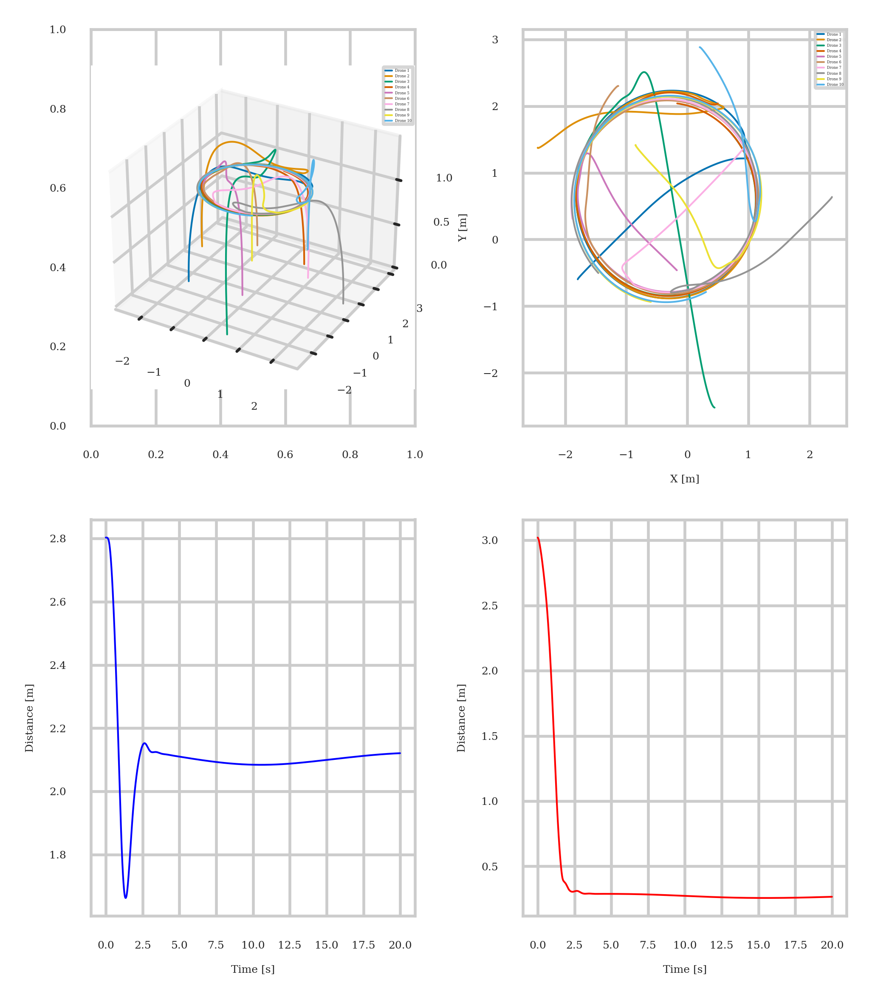

In [3]:
# IEEE-style plot settings
sns.set_style('whitegrid')
sns.set_palette('colorblind')
plt.rcParams.update({
    'font.family': 'serif',        # Print-friendly serif font
    'font.size': 5,                # General font size
    'axes.labelsize': 3,           # Axis label size
    'legend.fontsize': 3,          # Legend font size
    'xtick.labelsize': 3,          # X-axis tick size
    'ytick.labelsize': 3,          # Y-axis tick size
    'figure.dpi': 600              # High resolution for export
})

# Assumptions:
# - states.shape == (num_drones, num_states, timesteps)
#     * states[i, 0, :] = x, states[i, 1, :] = y, states[i, 2, :] = z
# - controls.shape == (num_drones, num_desired_states, timesteps)
#     * controls[i, 0, :] = desired x, controls[i, 1, :] = desired y, controls[i, 2, :] = desired z
# - timestamps.shape == (num_drones, timesteps) or a common time vector per drone

# If timestamps are the same for all drones, you can use:
t = timestamps[0, :] if timestamps.shape[0] > 0 else np.linspace(0, 10, states.shape[2])
num_drones = states.shape[0]
timesteps = states.shape[2]

# -------------------------------
# Compute Mean Inter-Drone Distance
# -------------------------------
mean_distance_between = np.zeros(timesteps)
for k in range(timesteps):
    positions = states[:, 0:3, k]  # Positions (x,y,z) for all drones
    dist_sum = 0
    count = 0
    for i in range(num_drones):
        for j in range(i+1, num_drones):
            d = np.linalg.norm(positions[i] - positions[j])
            dist_sum += d
            count += 1
    mean_distance_between[k] = dist_sum / count if count > 0 else 0

# -------------------------------
# Compute Mean Distance to Setpoint
# -------------------------------
mean_distance_to_setpoint = np.zeros(timesteps)
for k in range(timesteps):
    error_sum = 0
    for i in range(num_drones):
        # Current position vs. desired setpoint
        position = states[i, 0:3, k]
        setpoint = controls[i, 0:3, k]
        error_sum += np.linalg.norm(position - setpoint)
    mean_distance_to_setpoint[k] = error_sum / num_drones

linewidth = 0.5
labelpad = 0
# -------------------------------
# Create IEEE-Style Subplots
# -------------------------------
fig, axs = plt.subplots(2, 2, figsize=(3.5, 4))

# --- Subplot 1: 3D Trajectories ---
# For 3D plots, add a 3D axis manually
ax1 = fig.add_subplot(2, 2, 1, projection='3d')
for i in range(num_drones):
    ax1.plot(states[i, 0, :], states[i, 1, :], states[i, 2, :], label=f'Drone {i+1}', linewidth=linewidth)
# ax1.set_xlabel('X [m]', labelpad=labelpad)
# ax1.set_ylabel('Y [m]', labelpad=labelpad)
# ax1.set_zlabel('Z [m]', labelpad=labelpad)
ax1.tick_params(axis='x', labelsize=3, pad=0)
ax1.tick_params(axis='y', labelsize=3, pad=0)
ax1.tick_params(axis='z', labelsize=3, pad=0)
# ax1.set_xticks(np.arange(-3, 3, 1))
# ax1.set_yticks(np.arange(-3, 3, 1))
ax1.set_zticks(np.arange(0, 1.5, 0.5))
ax1.legend(fontsize=1)

# --- Subplot 2: 2D Trajectories (XY Projection) ---
ax2 = axs[0, 1]
for i in range(num_drones):
    ax2.plot(states[i, 0, :], states[i, 1, :], label=f'Drone {i+1}', linewidth=linewidth)
ax2.set_xlabel('X [m]')
ax2.set_ylabel('Y [m]')
ax2.legend(fontsize=1)

# --- Subplot 3: Mean Inter-Drone Distance ---
ax3 = axs[1, 0]
ax3.plot(t, mean_distance_between, 'b-', linewidth=linewidth)
ax3.set_xlabel('Time [s]')
ax3.set_ylabel('Distance [m]')
ax3.grid(True)

# --- Subplot 4: Mean Distance to Setpoint ---
ax4 = axs[1, 1]
ax4.plot(t, mean_distance_to_setpoint, 'r-', linewidth=linewidth)
ax4.set_xlabel('Time [s]')
ax4.set_ylabel('Distance [m]')
ax4.grid(True)

# Improve layout to reduce overlap
plt.tight_layout(pad=2)
plt.savefig("concensus.png", dpi=600)
plt.show()

In [1]:
import os
import time
import argparse
from datetime import datetime
import pdb
import math
import random
import numpy as np
import pybullet as p
import matplotlib.pyplot as plt

from gym_pybullet_drones.utils.enums import DroneModel, Physics
from gym_pybullet_drones.envs.CtrlAviary import CtrlAviary
from controllers.pid_controller import DSLPIDControl
from gym_pybullet_drones.utils.Logger import Logger
from gym_pybullet_drones.utils.utils import sync, str2bool

from utils.utils import initialize_drones

DEFAULT_DRONES = DroneModel("cf2x")
DEFAULT_NUM_DRONES = 50
DEFAULT_PHYSICS = Physics("pyb")
DEFAULT_GUI = True
DEFAULT_RECORD_VISION = False
DEFAULT_PLOT = True
DEFAULT_USER_DEBUG_GUI = False
DEFAULT_OBSTACLES = False
DEFAULT_SIMULATION_FREQ_HZ = 240
DEFAULT_CONTROL_FREQ_HZ = 120
DEFAULT_DURATION_SEC = 20
DEFAULT_OUTPUT_FOLDER = 'results'
DEFAULT_COLAB = False

def behaviour(obs, num_drones, separation_weight=1.5, alignment_weight=1.0, cohesion_weight=2.0):
    positions = np.array([o[0:3] for o in obs])
    velocities = np.array([o[10:13] for o in obs])  # Assuming vel is at index 10-13
    target_positions = np.zeros_like(positions)

    for i in range(num_drones):
        pos_i = positions[i]
        vel_i = velocities[i]

        separation = np.zeros(3)
        alignment = np.zeros(3)
        cohesion = np.zeros(3)
        neighbor_count = 0

        for j in range(num_drones):
            if i != j:
                pos_j = positions[j]
                vel_j = velocities[j]
                dist = np.linalg.norm(pos_j - pos_i)
                if dist < 2.0 and dist > 1e-2:
                    separation += (pos_i - pos_j) / (dist**2)
                    alignment += vel_j
                    cohesion += pos_j
                    neighbor_count += 1

        if neighbor_count > 0:
            separation /= neighbor_count
            alignment /= neighbor_count
            cohesion = (cohesion / neighbor_count) - pos_i

        behaviour_vector = (
            separation_weight * separation +
            alignment_weight * alignment +
            cohesion_weight * cohesion
        )

        next_pos = pos_i + behaviour_vector * 0.1  # timestep gain
        next_pos[2] = 1.0  # Fixed altitude
        target_positions[i] = next_pos

    return target_positions

def run(
        drone=DEFAULT_DRONES,
        num_drones=DEFAULT_NUM_DRONES,
        physics=DEFAULT_PHYSICS,
        gui=DEFAULT_GUI,
        record_video=DEFAULT_RECORD_VISION,
        plot=DEFAULT_PLOT,
        user_debug_gui=DEFAULT_USER_DEBUG_GUI,
        obstacles=DEFAULT_OBSTACLES,
        simulation_freq_hz=DEFAULT_SIMULATION_FREQ_HZ,
        control_freq_hz=DEFAULT_CONTROL_FREQ_HZ,
        duration_sec=DEFAULT_DURATION_SEC,
        output_folder=DEFAULT_OUTPUT_FOLDER,
        colab=DEFAULT_COLAB
        ):


    R = 1.3
    d = 0.5
    INIT_XYZS = INIT_XYZS = initialize_drones(num_drones, 0.5, [-3,3])
    INIT_RPYS = np.array([[0, 0,  0] for i in range(num_drones)])

    target_xyzs = np.array([[0, i*d, 1] for i in range(num_drones)])
    target_rpys = np.array([[0, 0, 0] for i in range(num_drones)])

    env = CtrlAviary(drone_model=drone,
                        num_drones=num_drones,
                        initial_xyzs=INIT_XYZS,
                        initial_rpys=INIT_RPYS,
                        physics=physics,
                        neighbourhood_radius=10,
                        pyb_freq=simulation_freq_hz,
                        ctrl_freq=control_freq_hz,
                        gui=gui,
                        record=record_video,
                        obstacles=obstacles,
                        user_debug_gui=user_debug_gui
                        )
    

    PYB_CLIENT = env.getPyBulletClient()
    p.configureDebugVisualizer(p.COV_ENABLE_GUI,0)
    logger = Logger(logging_freq_hz=control_freq_hz,
                    num_drones=num_drones,
                    output_folder=output_folder,
                    colab=colab
                    )

    if drone in [DroneModel.CF2X, DroneModel.CF2P]:
        ctrl = [DSLPIDControl(drone_model=drone) for i in range(num_drones)]

    action = np.zeros((num_drones,4))
    START = time.time()
    for i in range(0, int(duration_sec*env.CTRL_FREQ)):
        obs, reward, terminated, truncated, info = env.step(action)
        target_xyzs = behaviour(obs, num_drones) 

        for j in range(num_drones):
            action[j,:], _, _  = ctrl[j].computeControlFromState(control_timestep=env.CTRL_TIMESTEP, # action[j, :], _, _
                                                                    state=obs[j],
                                                                    target_pos=target_xyzs[j],
                                                                    # target_vel=state.vel,
                                                                    target_rpy=target_rpys[j, :]
                                                                    )

        for j in range(num_drones):
            logger.log(drone=j,
                       timestamp=i/env.CTRL_FREQ,
                       state=obs[j],
                       control=np.hstack((target_xyzs[j, :], target_rpys[j, :], np.zeros(6)))
                       )

        env.render()

        if gui:
            sync(i, START, env.CTRL_TIMESTEP)

    env.close()
    states = logger.states
    controls = logger.controls
    timestamps = logger.timestamps

    return states, controls, timestamps

states, controls, timestamps = run()

pybullet build time: Dec 23 2024 16:41:47


[INFO] BaseAviary.__init__() loaded parameters from the drone's .urdf:
[INFO] m 0.027000, L 0.039700,
[INFO] ixx 0.000014, iyy 0.000014, izz 0.000022,
[INFO] kf 0.000000, km 0.000000,
[INFO] t2w 2.250000, max_speed_kmh 30.000000,
[INFO] gnd_eff_coeff 11.368590, prop_radius 0.023135,
[INFO] drag_xy_coeff 0.000001, drag_z_coeff 0.000001,
[INFO] dw_coeff_1 2267.180000, dw_coeff_2 0.160000, dw_coeff_3 -0.110000
Version = 4.1 Metal - 89.3
Vendor = Apple
Renderer = Apple M1
b3Printf: Selected demo: Physics Server
startThreads creating 1 threads.
starting thread 0
started thread 0 
MotionThreadFunc thread started
viewMatrix (0.642787516117096, -0.4393851161003113, 0.6275069713592529, 0.0, 0.766044557094574, 0.36868777871131897, -0.5265407562255859, 0.0, -0.0, 0.8191521167755127, 0.5735764503479004, 0.0, 2.1817449180616677e-07, 1.4121394542598864e-07, -5.000000476837158, 1.0)
projectionMatrix (0.7499999403953552, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, -1.0000200271606445, -1.0, 0.0, 0.0,

2025-04-14 15:03:57.319 python[45989:16444824] +[IMKClient subclass]: chose IMKClient_Modern
2025-04-14 15:03:57.319 python[45989:16444824] +[IMKInputSession subclass]: chose IMKInputSession_Modern
/Users/timii/miniforge3/envs/ai/lib/python3.12/site-packages/gymnasium/spaces/box.py:235: UserWarning: WARN: Box low's precision lowered by casting to float32, current low.dtype=float64
  gym.logger.warn(
/Users/timii/miniforge3/envs/ai/lib/python3.12/site-packages/gymnasium/spaces/box.py:305: UserWarning: WARN: Box high's precision lowered by casting to float32, current high.dtype=float64
  gym.logger.warn(



[INFO] BaseAviary.render() ——— it 0002 ——— wall-clock time 39.2s, simulation time 0.0s@240Hz (0.00x)
[INFO] BaseAviary.render() ——— drone 0 ——— x -02.79, y -01.50, z +00.00 ——— velocity +00.00, -00.01, +00.25 ——— roll -00.34, pitch -01.19, yaw +00.00 ——— angular velocity +0.5004, +0.2832, -0.0016 ——— 
[INFO] BaseAviary.render() ——— drone 1 ——— x -00.65, y -00.91, z +00.00 ——— velocity +00.00, -00.00, +00.26 ——— roll -00.80, pitch -00.84, yaw +00.01 ——— angular velocity +0.3569, +0.2404, +0.0018 ——— 
[INFO] BaseAviary.render() ——— drone 2 ——— x +00.32, y +00.04, z +00.00 ——— velocity -00.00, -00.00, +00.24 ——— roll -00.00, pitch +00.01, yaw -00.00 ——— angular velocity +0.0043, -0.0029, -0.0000 ——— 
[INFO] BaseAviary.render() ——— drone 3 ——— x +02.24, y +02.91, z +00.00 ——— velocity -00.01, +00.01, +00.25 ——— roll -01.04, pitch -00.47, yaw +00.02 ——— angular velocity +0.4136, +0.0934, +0.0760 ——— 
[INFO] BaseAviary.render() ——— drone 4 ——— x -02.85, y +01.57, z +00.00 ——— velocity +00.0

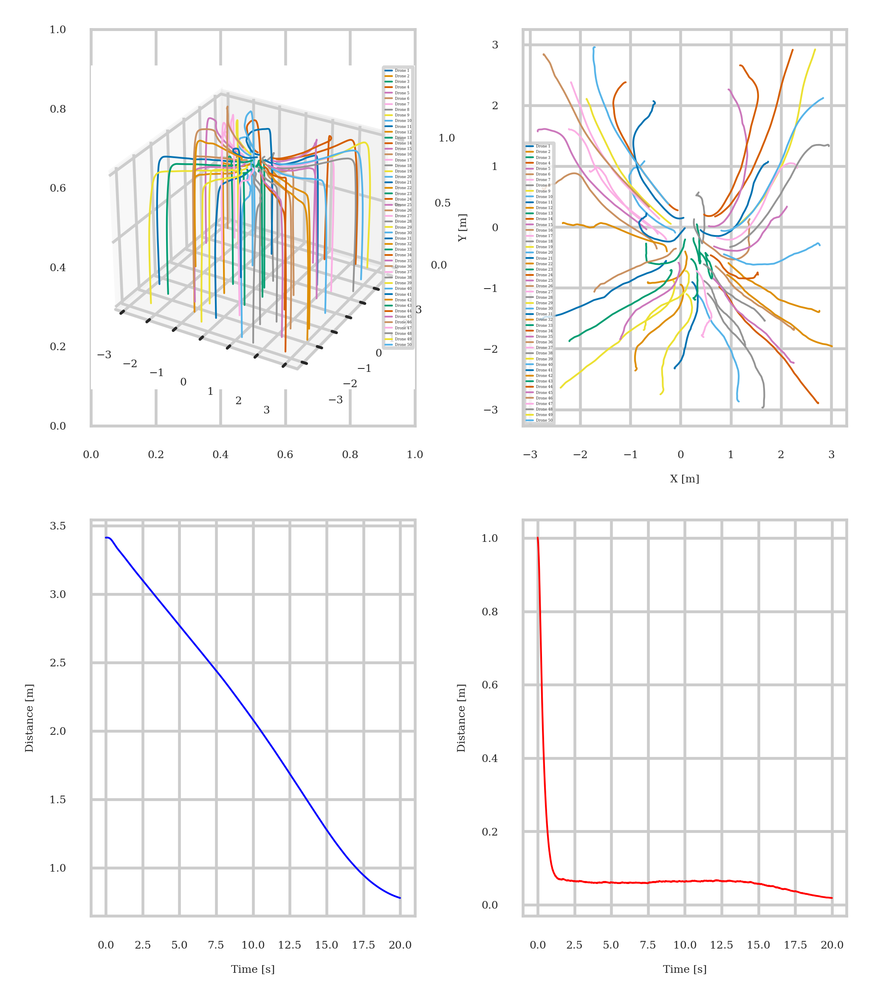

In [3]:
# IEEE-style plot settings
import seaborn as sns
sns.set_style('whitegrid')
sns.set_palette('colorblind')
plt.rcParams.update({
    'font.family': 'serif',        # Print-friendly serif font
    'font.size': 5,                # General font size
    'axes.labelsize': 3,           # Axis label size
    'legend.fontsize': 3,          # Legend font size
    'xtick.labelsize': 3,          # X-axis tick size
    'ytick.labelsize': 3,          # Y-axis tick size
    'figure.dpi': 600              # High resolution for export
})

# Assumptions:
# - states.shape == (num_drones, num_states, timesteps)
#     * states[i, 0, :] = x, states[i, 1, :] = y, states[i, 2, :] = z
# - controls.shape == (num_drones, num_desired_states, timesteps)
#     * controls[i, 0, :] = desired x, controls[i, 1, :] = desired y, controls[i, 2, :] = desired z
# - timestamps.shape == (num_drones, timesteps) or a common time vector per drone

# If timestamps are the same for all drones, you can use:
t = timestamps[0, :] if timestamps.shape[0] > 0 else np.linspace(0, 10, states.shape[2])
num_drones = states.shape[0]
timesteps = states.shape[2]

# -------------------------------
# Compute Mean Inter-Drone Distance
# -------------------------------
mean_distance_between = np.zeros(timesteps)
for k in range(timesteps):
    positions = states[:, 0:3, k]  # Positions (x,y,z) for all drones
    dist_sum = 0
    count = 0
    for i in range(num_drones):
        for j in range(i+1, num_drones):
            d = np.linalg.norm(positions[i] - positions[j])
            dist_sum += d
            count += 1
    mean_distance_between[k] = dist_sum / count if count > 0 else 0

# -------------------------------
# Compute Mean Distance to Setpoint
# -------------------------------
mean_distance_to_setpoint = np.zeros(timesteps)
for k in range(timesteps):
    error_sum = 0
    for i in range(num_drones):
        # Current position vs. desired setpoint
        position = states[i, 0:3, k]
        setpoint = controls[i, 0:3, k]
        error_sum += np.linalg.norm(position - setpoint)
    mean_distance_to_setpoint[k] = error_sum / num_drones

linewidth = 0.5
labelpad = 0
# -------------------------------
# Create IEEE-Style Subplots
# -------------------------------
fig, axs = plt.subplots(2, 2, figsize=(3.5, 4))

# --- Subplot 1: 3D Trajectories ---
# For 3D plots, add a 3D axis manually
ax1 = fig.add_subplot(2, 2, 1, projection='3d')
for i in range(num_drones):
    ax1.plot(states[i, 0, :], states[i, 1, :], states[i, 2, :], label=f'Drone {i+1}', linewidth=linewidth)
# ax1.set_xlabel('X [m]', labelpad=labelpad)
# ax1.set_ylabel('Y [m]', labelpad=labelpad)
# ax1.set_zlabel('Z [m]', labelpad=labelpad)
ax1.tick_params(axis='x', labelsize=3, pad=0)
ax1.tick_params(axis='y', labelsize=3, pad=0)
ax1.tick_params(axis='z', labelsize=3, pad=0)
# ax1.set_xticks(np.arange(-3, 3, 1))
# ax1.set_yticks(np.arange(-3, 3, 1))
ax1.set_zticks(np.arange(0, 1.5, 0.5))
ax1.legend(fontsize=1)

# --- Subplot 2: 2D Trajectories (XY Projection) ---
ax2 = axs[0, 1]
for i in range(num_drones):
    ax2.plot(states[i, 0, :], states[i, 1, :], label=f'Drone {i+1}', linewidth=linewidth)
ax2.set_xlabel('X [m]')
ax2.set_ylabel('Y [m]')
ax2.legend(fontsize=1)

# --- Subplot 3: Mean Inter-Drone Distance ---
ax3 = axs[1, 0]
ax3.plot(t, mean_distance_between, 'b-', linewidth=linewidth)
ax3.set_xlabel('Time [s]')
ax3.set_ylabel('Distance [m]')
ax3.grid(True)

# --- Subplot 4: Mean Distance to Setpoint ---
ax4 = axs[1, 1]
ax4.plot(t, mean_distance_to_setpoint, 'r-', linewidth=linewidth)
ax4.set_xlabel('Time [s]')
ax4.set_ylabel('Distance [m]')
ax4.grid(True)

# Improve layout to reduce overlap
plt.tight_layout(pad=2)
plt.savefig("behaviour.png", dpi=600)
plt.show()